In [1]:
import sys,os

try:
    from localgraphclustering import *
except:
    # when the package is not installed, import the local version instead. 
    # the notebook must be placed in the original "notebooks/" folder
    sys.path.append("../")
    from localgraphclustering import *

import time
import numpy as np
import pickle

# Import matplotlib 
import matplotlib.pyplot as plt

# Load graph

In [12]:
# Read graph. This also supports gml and graphml format.
g = GraphLocal('./datasets/senate.graphml','graphml')

# Global graph partitioning

In [13]:
# Call the global spectral partitioning algorithm.
eig2 = fiedler(g,normalize=False)[0]

In [14]:
ld_coord = np.loadtxt('./datasets/senate.xy', dtype = 'Float64')

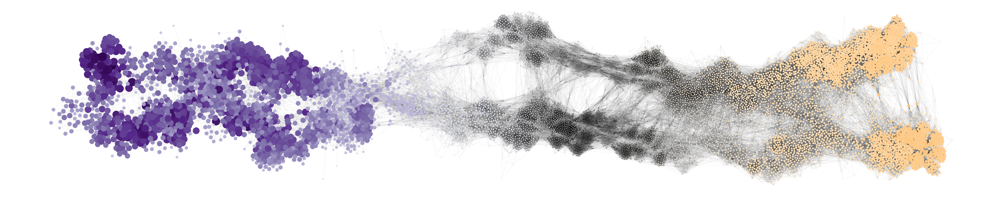

In [15]:
drawing = g.draw(ld_coord,values=eig2,figsize=(100,20),nodesize=(np.abs(eig2)*1500)**2,edgealpha=0.1,valuecenter=0)

## Obtain the partition using the global eigenvector

In [ ]:
# Round the eigenvector
output_sc = sweep_cut(g,eig2)

# Extract the partition for g and store it.
eig2_rounded = output_sc[0]

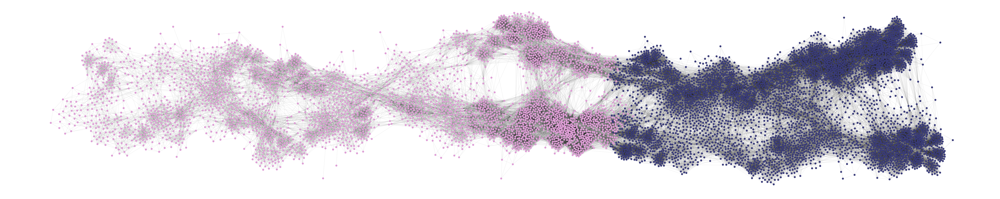

In [ ]:
drawing = g.draw(ld_coord,nodeset=eig2_rounded,figsize=(100,20),nodesize=10**2,edgealpha=0.1)

## Global partitioning of John Hopkins

In [ ]:
# Read John Hopkins graph.
g = GraphLocal('./datasets/JohnsHopkins.graphml','graphml','\t')

# Call the global spectral partitioning algorithm.
eig2 = fiedler(g)[0]

# Round the eigenvector
output_sc = sweep_cut(g,eig2)

# Extract the partition for g and store it.
eig2_rounded = output_sc[0]

In [ ]:
ld_coord = np.loadtxt('./datasets/JohnHopkins_coord.xy', dtype = 'Float64')
idx = np.argsort(ld_coord[:,0])
pos = np.zeros((g._num_vertices,2))
for i in range(g._num_vertices):
    pos[i] = ld_coord[idx[i],1:3]

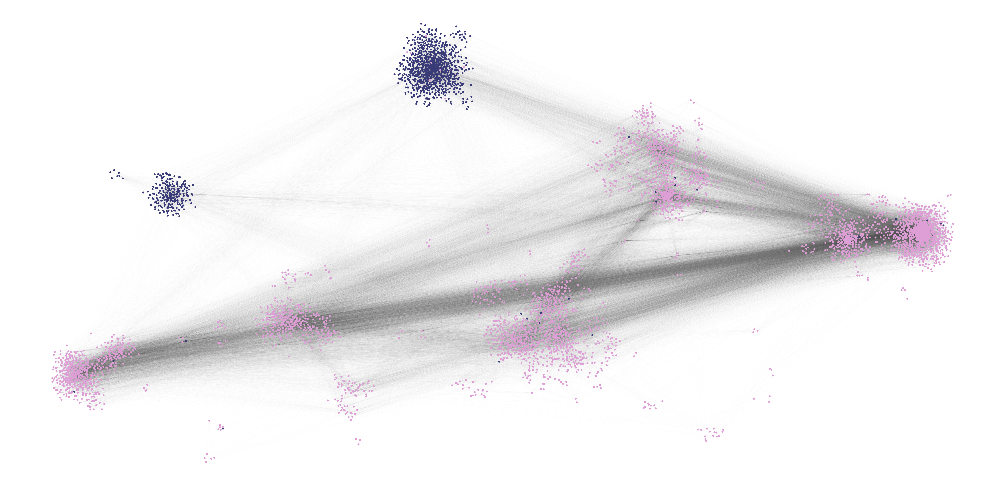

In [ ]:
drawing = g.draw(pos,nodeset=eig2_rounded,figsize=(100,50),nodesize=10**2,edgealpha=0.01)

## Localized vector using l1-regularized PageRank

In [ ]:
# Read John Hopkins graph; a better graph than senate to demonstrate local graph clustering properties.
g = GraphLocal('./datasets/JohnsHopkins.graphml','graphml','\t')

# Find the solution of L1-regularized PageRank using localized accelerated gradient descent.
# This method is the fastest among other l1-regularized solvers and other approximate PageRank solvers.
reference_node = [2767]
l1_reg_vector = approximate_PageRank(g,reference_node,rho=5.0e-5,method="l1reg")

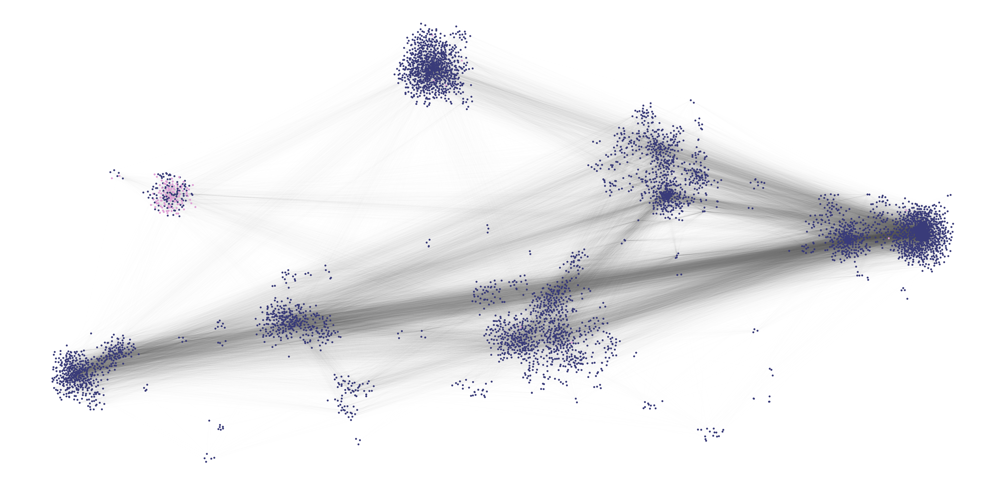

In [ ]:
drawing = g.draw(pos,nodeset=l1_reg_vector[0],figsize=(100,50),nodesize=10**2,edgealpha=0.01)

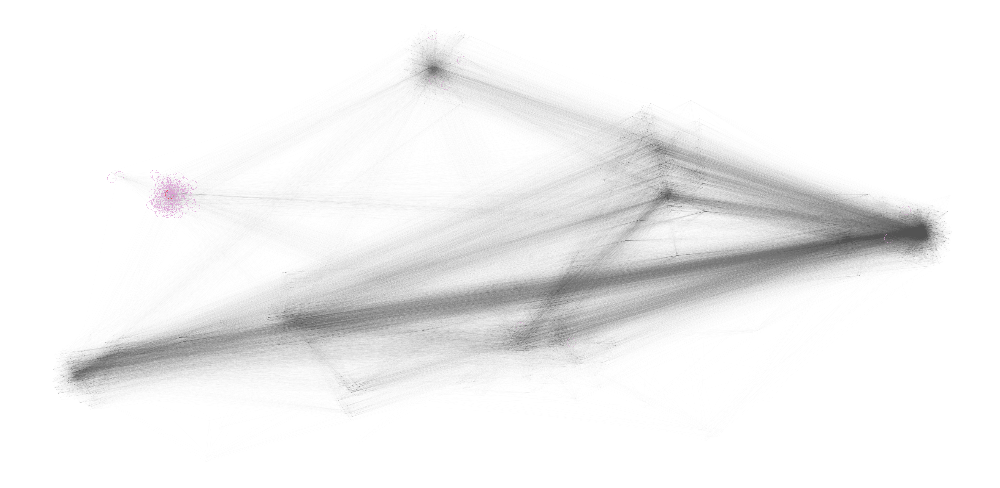

In [27]:
# Highlight local cluster
drawing.highlight(l1_reg_vector[0],otheredges=True)
drawing.nodesize(l1_reg_vector[0],50**2)
drawing.show()

In [ ]:
# Make reference node larger and more obvious
drawing.nodecolor(reference_node,edgecolor='y',facecolor='b',alpha=1)
drawing.nodesize(l1_reg_vector[0],80**2)
drawing.show()

# Load Protein-Protein interaction graph

In [2]:
# Read graph. This also supports gml and graphml format.
# The MIPS Mammalian Protein-Protein Database is a database for protein-protein interactions of mammalian species. 
# We used the data set proposed in consisting of a subset of 220 protein complexes of 1562 proteins. 
# Details can be found here: https://clusteval.sdu.dk/1/datasets/685
g = GraphLocal('./datasets/ppi_mips.graphml','graphml',' ')

../localgraphclustering/GraphLocal.py:217: UserWarning:

Loading a graphml is not efficient, we suggest using an edgelist format for this API.



In [3]:
# Load pre-computed coordinates for nodes.
pos = np.loadtxt('./datasets/ppi_mips.xy', dtype = 'float')

In [4]:
groups = np.loadtxt('./datasets/ppi_mips.class', dtype = 'float')

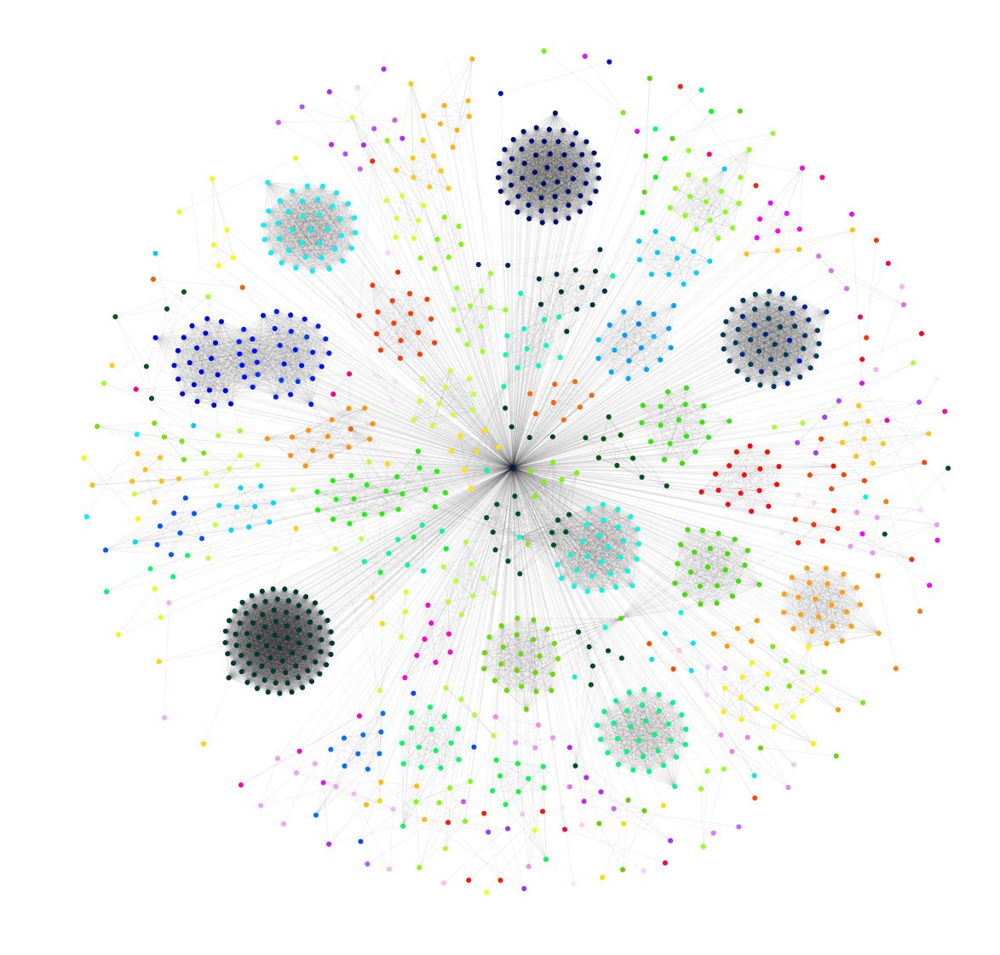

In [5]:
drawing = g.draw(pos,groups=groups,figsize=(20,20),nodesize=5**2,edgealpha=0.05)